## 3D Photo Inpainting - Turn Any Picture Into 3D Photo with Deep Learning and Python

> TL;DR Learn how to create a 3D photo from a regular image using Machine Learning

Have you seen those amazing 3D photos on Facebook and Instagram? How can you create your own from regular photos? We're going to do that with the help of a project called: [**3D Photography using Context-aware Layered Depth Inpainting**](https://shihmengli.github.io/3D-Photo-Inpainting/). We'll try out different photos, and have a look at how it all works!

- [Read the tutorial](https://www.curiousily.com/posts/3d-photo-inpainting-turn-any-picture-into-3d-photo-with-deep-learning-and-python/)
- [Run the notebook in your browser (Google Colab)](https://colab.research.google.com/drive/10ECFY76fPco5DhMTKsj7ZZ6Hm_mI9K6g?usp=sharing)
- [Read the `Getting Things Done with Pytorch` book](https://github.com/curiousily/Getting-Things-Done-with-Pytorch)

Here's what we'll go over:

- Install the prerequisites for the 3D photo inpainting project
- Look at a demo
- Convert some images into 3D photos
- Dive deeper into how it works
- Look into what training data was used

Let's make some 3D photos!

In [ ]:
!nvidia-smi

Thu Sep  9 12:31:54 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8    28W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Prerequisites

The 3D inpainting project requires some libraries preinstalled. Let's get those:

In [ ]:
!pip install -q vispy==0.6.4
!pip install -q moviepy==1.0.2
!pip install -q transforms3d==0.3.1
!pip install -q networkx==2.3
!pip install -q -U watermark

     |████████████████████████████████| 2.3 MB 13.1 MB/s 
     |████████████████████████████████| 890 kB 35.7 MB/s 
     |████████████████████████████████| 7.8 MB 9.9 MB/s 
     |████████████████████████████████| 3.3 MB 37.7 MB/s 
     |████████████████████████████████| 26.9 MB 83 kB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 62 kB 1.3 MB/s 
     |████████████████████████████████| 1.7 MB 10.4 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [ ]:
%reload_ext watermark
%watermark -v -p torch,vispy,moviepy,transforms3d,networkx

Python implementation: CPython
Python version       : 3.7.11
IPython version      : 5.5.0

torch       : 1.9.0+cu102
vispy       : 0.6.4
moviepy     : 1.0.2
transforms3d: 0.3.1
networkx    : 2.3



We'll also define two helper functions that'll help us visualize depth estimations and final results:

In [ ]:
from IPython.display import HTML
from base64 import b64encode

def show_inpainting(image_file, video_file):
  image_content = open(image_file, 'rb').read()
  video_content = open(video_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  video_data = "data:video/mp4;base64," + b64encode(video_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <video height=756 controls loop>
        <source src={video_data} type='video/mp4'>
  </video>
  """)
  return html

def show_depth_estimation(image_file, depth_file):
  image_content = open(image_file, 'rb').read()
  depth_content = open(depth_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  depth_data = "data:image/png;base64," + b64encode(depth_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <img height=756 src={depth_data} />
  """)
  return html

The `show_inpainting()` function shows the inpainted video along with the original photo. `show_depth_estimation()` shows the estimated depth of each pixel of the image (more on that later).

## Demo

Let's see what we're going to achieve:


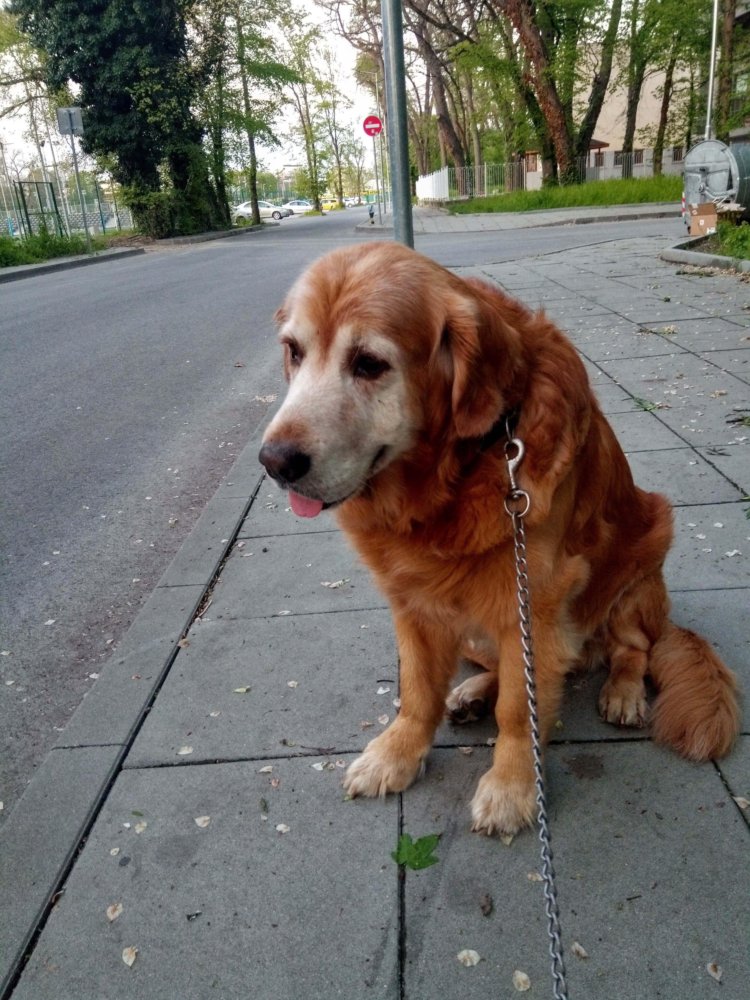

In [ ]:
!mkdir demo
!gdown -q --id 1VDT5YhANPJczevyhTdasJO5Zexl2l_fd -O demo/dog.jpg
!gdown -q --id 1CAsRBub83ptC_zPWFRZIDQDU47tFy_ST -O demo/dog-inpainting.mp4

show_inpainting('demo/dog.jpg', 'demo/dog-inpainting.mp4')

On the left, we have a photo of Ahil that I've taken with my phone. On the right is the result of the 3D inpainting that you're going to learn how to do.

## Making 3D photos

*Inpainting* refers to the process of recovering parts of images and videos that were lost or purposefully removed.

The paper [3D Photography using Context-aware Layered Depth Inpainting](https://shihmengli.github.io/3D-Photo-Inpainting/) introduces a method to convert 2D photos into 3D using inpainting techniques.

The full source code of the project is available on [GitHub](https://github.com/vt-vl-lab/3d-photo-inpainting). Let's clone the repo and download some pre-trained models:

In [ ]:
%cd /content/
!git clone https://github.com/vt-vl-lab/3d-photo-inpainting.git
%cd 3d-photo-inpainting
!git checkout e804c1cb2fd695be50946db2f1eb17134f6d1b38
!sh download.sh

/content
Cloning into '3d-photo-inpainting'...
remote: Enumerating objects: 372, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 372 (delta 9), reused 15 (delta 9), pack-reused 350
Receiving objects: 100% (372/372), 130.14 MiB | 22.83 MiB/s, done.
Resolving deltas: 100% (201/201), done.
/content/3d-photo-inpainting
Note: checking out 'e804c1cb2fd695be50946db2f1eb17134f6d1b38'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at e804c1c Manually edited depth map.
--2021-09-09 12:33:31--  https://filebox.ece.vt.edu/~jbhuang/project/3DPhoto/model/color-model.pth


In [ ]:
!rm depth/*
!rm image/*
!rm video/*

Let's clear up the demo files, provided by the project, and download our own content:

In [ ]:
!gdown --id 1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z -O config.yml
!gdown --id 1TYmKRP4387hjDMFfWaeqcOVY7do-m0LE -O image/castle.jpg
!gdown --id 1VDT5YhANPJczevyhTdasJO5Zexl2l_fd -O image/dog.jpg

Downloading...
From: https://drive.google.com/uc?id=1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z
To: /content/3d-photo-inpainting/config.yml
100% 1.22k/1.22k [00:00<00:00, 2.82MB/s]
Downloading...
From: https://drive.google.com/uc?id=1TYmKRP4387hjDMFfWaeqcOVY7do-m0LE
To: /content/3d-photo-inpainting/image/castle.jpg
2.36MB [00:00, 75.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1VDT5YhANPJczevyhTdasJO5Zexl2l_fd
To: /content/3d-photo-inpainting/image/dog.jpg
3.06MB [00:00, 97.4MB/s]


The images you want to convert into 3D photos need to go into the `image` directory. For our example, I am adding 2 from my personal collection.

We're going to use (mostly) the default config and make sure that offscreen rendering is disabled:

In [ ]:
!cat config.yml

depth_edge_model_ckpt: checkpoints/edge-model.pth
depth_feat_model_ckpt: checkpoints/depth-model.pth
rgb_feat_model_ckpt: checkpoints/color-model.pth
MiDaS_model_ckpt: MiDaS/model.pt
fps: 40
num_frames: 240
x_shift_range: [0.00, 0.00, -0.02, -0.02]
y_shift_range: [0.00, 0.00, -0.02, -0.00]
z_shift_range: [-0.05, -0.05, -0.07, -0.07]
traj_types: ['double-straight-line', 'double-straight-line', 'circle', 'circle']
video_postfix: ['dolly-zoom-in', 'zoom-in', 'circle', 'swing']
specific: ''
longer_side_len: 960
src_folder: image
depth_folder: depth
mesh_folder: mesh
video_folder: video
load_ply: False
save_ply: True
inference_video: True
gpu_ids: 0
offscreen_rendering: False
img_format: '.jpg'
depth_format: '.npy'
require_midas: True
depth_threshold: 0.04
ext_edge_threshold: 0.002
sparse_iter: 5
filter_size: [7, 7, 5, 5, 5]
sigma_s: 4.0
sigma_r: 0.5
redundant_number: 12
background_thickness: 70
context_thickness: 140
background_thickness_2: 70
context_thickness_2: 70
discount_factor: 1.00


To start the inpainting process, we need to execute the `main.py` file and pass the config:

In [ ]:
!python main.py --config config.yml

running on device 0
  0% 0/2 [00:00<?, ?it/s]Current Source ==>  castle
Running depth extraction at 1631190866.8884737
initialize
device: cpu
start processing
  processing image/castle.jpg (1/1)
torch.Size([1, 3, 384, 288])
finished
Start Running 3D_Photo ...
Loading edge model at 1631190882.7544808
Loading depth model at 1631190892.5402029
Loading rgb model at 1631190893.3715603
Writing depth ply (and basically doing everything) at 1631190894.148031
Writing mesh file mesh/castle.ply ...
Making video at 1631191069.2851448
fov: 53.13010235415598
Moviepy - Building video video/castle_dolly-zoom-in.mp4.
Moviepy - Writing video video/castle_dolly-zoom-in.mp4

  0% 0/2 [04:01<?, ?it/s]
t:   0% 0/241 [00:00<?, ?it/s, now=None]
t:   1% 2/241 [00:00<00:37,  6.36it/s, now=None]
t:   1% 3/241 [00:00<00:32,  7.27it/s, now=None]
t:   8% 20/241 [00:00<00:03, 55.82it/s, now=None]
t:  15% 35/241 [00:00<00:02, 83.32it/s, now=None]
t:  20% 47/241 [00:00<00:02, 93.77it/s, now=None]
t:  24% 59/241 [00:01

This might take some time, depending on the GPU that you have.

### Estimated depth

I've promised you that we're going to look at the estimated depth later. The time has come, let's look at some depth estimations:


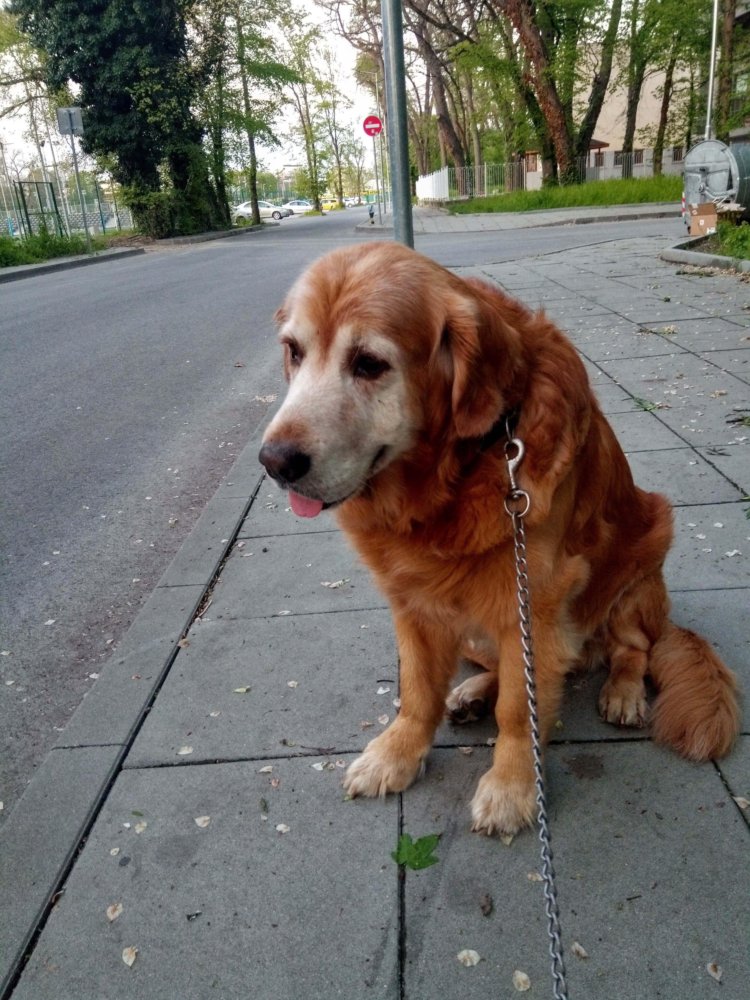
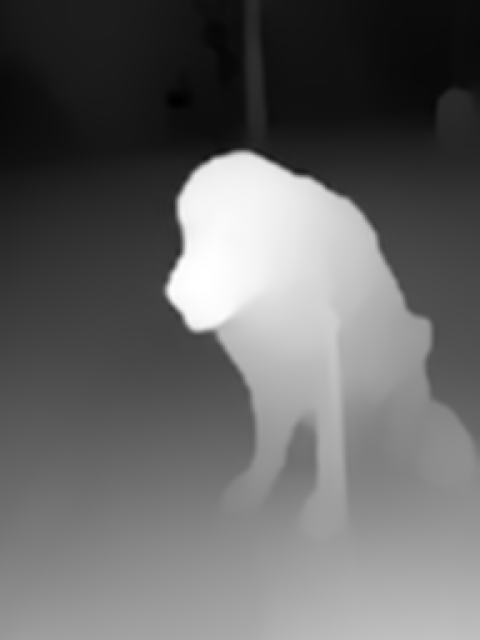

In [ ]:
show_depth_estimation('image/dog.jpg', 'depth/dog.png')


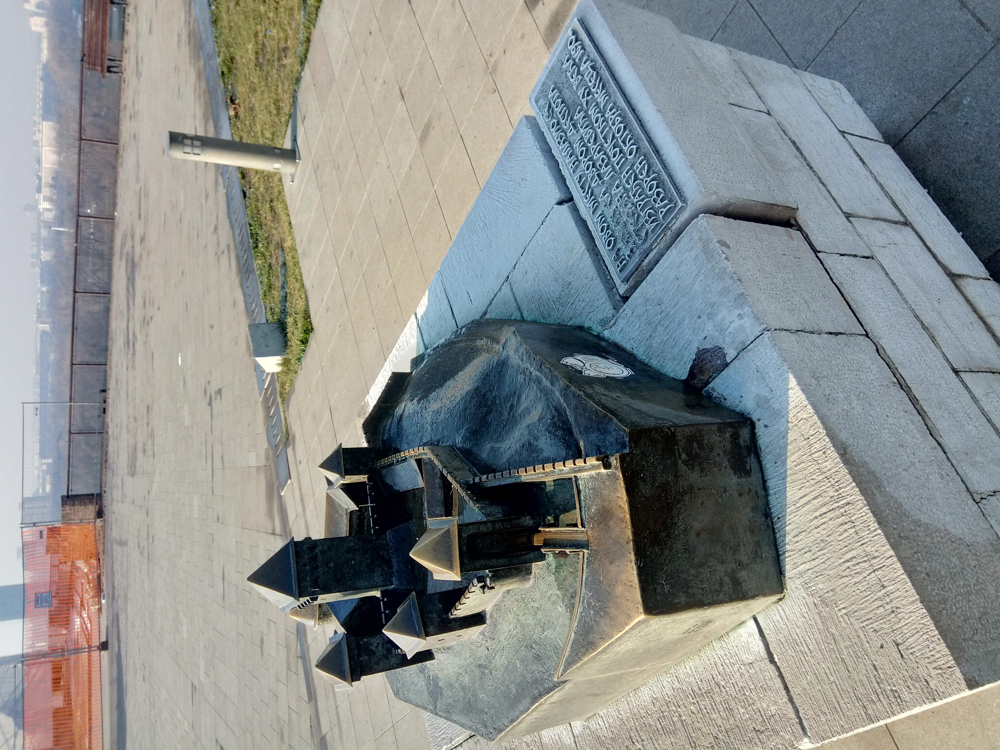
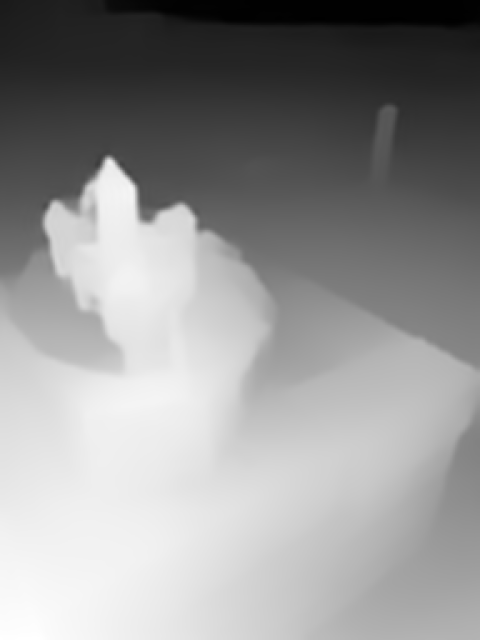

In [ ]:
show_depth_estimation('image/castle.jpg', 'depth/castle.png')

Lighter pixels represent shorter distance, relative to the camera. I would say that it's doing a great job!

### Results

Here are the 3D inpainting of the two images:


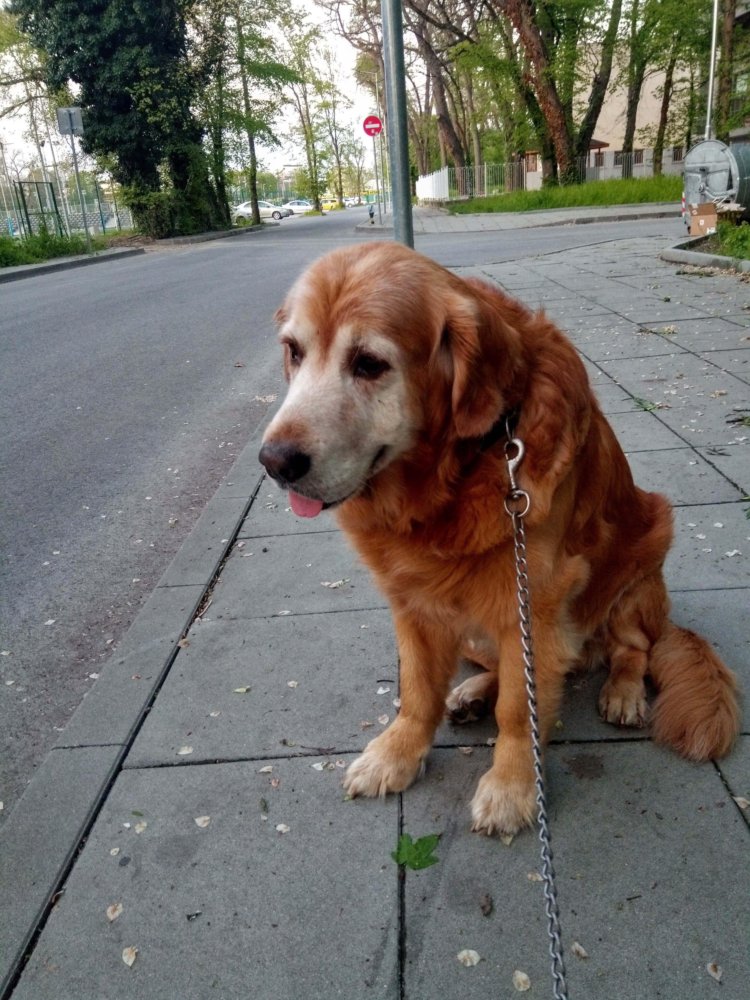

In [ ]:
show_inpainting('image/dog.jpg', 'video/dog_swing.mp4')


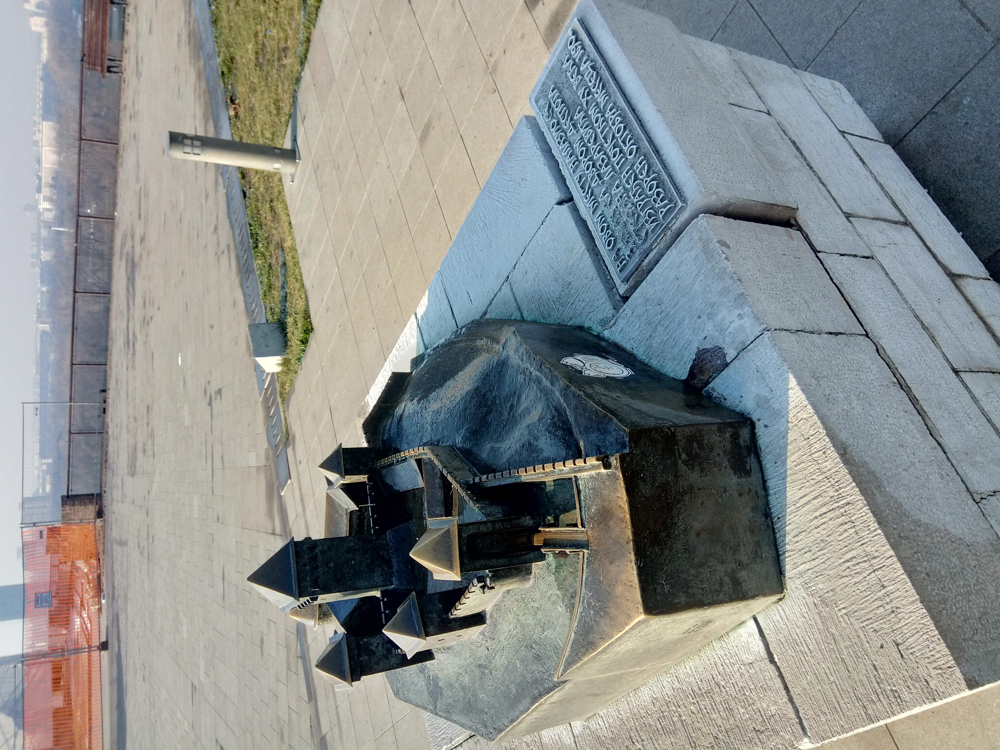

In [ ]:
show_inpainting('image/castle.jpg', 'video/castle_circle.mp4')

Amazing, right?

## How does it work?

Here is a high level overview:

- Get the depth of each pixel (how far back is from the camera)
 - RGB-D image from a dual-camera device (phone)
 
 or

 - Depth estimation with MiDaS: https://github.com/intel-isl/MiDaS
- Create LDI (layered depth image) representation
- Detect regions with a high depth difference (context/synthesis regions)
- Cut out those regions (this roughly resembles cutting out objects from the image)
- Generate the background behind the cut off objects
- Merge the background and cut out objects into a new LDI

The process is a lot more involved (including heavy image preprocessing), but you need to read the paper/code to get into the details.

## What was the training data?

The authors didn't create a special dataset for their task. They generate data.

First, the depth of images from the [MSCOCO dataset](http://cocodataset.org/) is estimated using a pre-trained [MegaDepth model](https://research.cs.cornell.edu/megadepth/). Then context/synthesis regions are extracted. A random sample of regions is merged with a set of images from the MSCOCO dataset. Thus, you get the ground truth of the backgrounds.

## Conclusion

You can now convert any image into a 3D photo! Pretty amazing, right?

- [Read the tutorial](https://www.curiousily.com/posts/3d-photo-inpainting-turn-any-picture-into-3d-photo-with-deep-learning-and-python/)
- [Run the notebook in your browser (Google Colab)](https://colab.research.google.com/drive/10ECFY76fPco5DhMTKsj7ZZ6Hm_mI9K6g?usp=sharing)
- [Read the `Getting Things Done with Pytorch` book](https://github.com/curiousily/Getting-Things-Done-with-Pytorch)

Here's what you've went over:

- Install the prerequisites for the 3D photo inpainting project
- Look at a demo
- Convert some images into 3D photos
- Dive deeper into how it works
- Look into what training data was used

Go on, try it on your own photos and show me the results in the comments!

## References

- [3D Photo Inpainting project webpage](https://shihmengli.github.io/3D-Photo-Inpainting/)
- [3D Photography using Context-aware Layered Depth Inpainting](https://arxiv.org/abs/2004.04727)
- [Towards Robust Monocular Depth Estimation: Mixing Datasets for Zero-shot Cross-dataset Transfer](https://arxiv.org/pdf/1907.01341v2.pdf)
